I am following the code from the project [[https://spandan-madan.github.io/DeepLearningProject/]]

In [1]:
from urllib.request import urlopen
import requests
import json
import imdb
import time
import itertools
import wget
import os
import tmdbsimple as tmdb
import numpy as np
import random
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import pickle

In [3]:
poster_folder = 'posters_final/'
if poster_folder.split('/'[0]) in os.listdir('./') :
    print('Folder already exists')
else :
        os.mkdir('./'+poster_folder)

FileExistsError: [WinError 183] Cannot create a file when that file already exists: './posters_final/'

In [4]:
api_key = '' # get it from tmdb developer api
tmdb.API_KEY = api_key
search = tmdb.Search()
def get_movie_genres_tmdb(movie):
    response = search.movie(query=movie)
    id = response['results'][0]['id']
    movie = tmdb.Movies(id)
    genres = movie.info()['genres']
    print(genres)

def get_movie_info_tmdb(movie):
    response = search.movie(query=movie)
    id = response['results'][0]['id'] #results contain dict, we are accessing the 1st hit
    movie = tmdb.Movies(id) # returns object
    info = movie.info()
    return info

info = get_movie_info_tmdb('The Matrix')
info.keys()
info['tagline']
#print(get_movie_genres_tmdb("The Matrix"))

'Welcome to the Real World.'

In [2]:
imdb_object = imdb.IMDb()
results = imdb_object.search_movie('The Matrix')
movie = results[0]
imdb_object.update(movie)
movie.keys()


['title',
 'kind',
 'year',
 'plot',
 'canonical title',
 'long imdb title',
 'long imdb canonical title',
 'smart canonical title',
 'smart long imdb canonical title']

In [5]:
movie['plot']

["Thomas A. Anderson is a man living two lives. By day he is an average computer programmer and by night a hacker known as Neo. Neo has always questioned his reality, but the truth is far beyond his imagination. Neo finds himself targeted by the police when he is contacted by Morpheus, a legendary computer hacker branded a terrorist by the government. Morpheus awakens Neo to the real world, a ravaged wasteland where most of humanity have been captured by a race of machines that live off of the humans' body heat and electrochemical energy and who imprison their minds within an artificial reality known as the Matrix. As a rebel against the machines, Neo must return to the Matrix and confront the agents: super-powerful computer programs devoted to snuffing out Neo and the entire human rebellion.::redcommander27",
 "Thomas A. Anderson ids a man leading a double life. By day, he isu an average computer programmer who pays his taxes and helps his landlady take out the garbage. At night, he i

In [6]:
results

[<Movie id:0133093[http] title:_The leading information resource for the entertainment industry (1999)_>,
 <Movie id:3268754[http] title:_"Honest Trailers" The Matrix (2013)_>,
 <Movie id:7223416[http] title:_"Chris Stuckmann Movie Reviews" The Matrix (2014)_>,
 <Movie id:0234215[http] title:_The Matrix Reloaded (2003)_>,
 <Movie id:0242653[http] title:_Matrix Revolutions (2003)_>,
 <Movie id:0295432[http] title:_The Matrix Revisited (2001) (V)_>,
 <Movie id:0390244[http] title:_The Matrix Online (2005) (VG)_>,
 <Movie id:0451118[http] title:_The Matrix: Path of Neo (2005) (VG)_>,
 <Movie id:0106062[http] title:_"Matrix" (1993)_>,
 <Movie id:0277828[http] title:_Enter the Matrix (2003) (VG)_>,
 <Movie id:0328832[http] title:_The Animatrix (2003) (V)_>,
 <Movie id:0274085[http] title:_Sex and the Matrix (2000)_>,
 <Movie id:1781960[http] title:_"5 Second Movies" The Matrix (2010)_>,
 <Movie id:4167406[http] title:_"Broad City" The Matrix (2015)_>,
 <Movie id:4255382[http] title:_"Nostal

In [5]:
all_movies = tmdb.Movies()
top_movies = all_movies.popular()
len(top_movies['results'])

20

In [6]:
top20_movs = top_movies['results']
first_movie = top20_movs[0]
first_movie
print("\n\n The title of the first movie is ", first_movie['title'])



 The title of the first movie is  It


In [7]:
for i in range(len(top20_movs)):
    mov = top20_movs[i]
    title = mov['title']
    print(title)
    if i == 4 :
        break

It
Star Wars: The Last Jedi
Jumanji: Welcome to the Jungle
Olaf's Frozen Adventure
Coco


In [8]:
for i in range(len(top20_movs)):
    mov = top20_movs[i]
    genres = mov['genre_ids']
    print(genres)
    if i == 4 :
        break
    

[53, 18, 27, 14]
[28, 12, 14, 878]
[28, 12, 35, 10751]
[12, 16, 35, 10751, 14, 10402]
[12, 16, 10751]


In [9]:
genres = tmdb.Genres()
list_of_genres = genres.list()['genres']
list_of_genres # returns the mapping of genre id to genre

[{'id': 28, 'name': 'Action'},
 {'id': 12, 'name': 'Adventure'},
 {'id': 16, 'name': 'Animation'},
 {'id': 35, 'name': 'Comedy'},
 {'id': 80, 'name': 'Crime'},
 {'id': 99, 'name': 'Documentary'},
 {'id': 18, 'name': 'Drama'},
 {'id': 10751, 'name': 'Family'},
 {'id': 14, 'name': 'Fantasy'},
 {'id': 36, 'name': 'History'},
 {'id': 27, 'name': 'Horror'},
 {'id': 10402, 'name': 'Music'},
 {'id': 9648, 'name': 'Mystery'},
 {'id': 10749, 'name': 'Romance'},
 {'id': 878, 'name': 'Science Fiction'},
 {'id': 10770, 'name': 'TV Movie'},
 {'id': 53, 'name': 'Thriller'},
 {'id': 10752, 'name': 'War'},
 {'id': 37, 'name': 'Western'}]

In [10]:
Genre_ID_to_name = {}
for i in range(len(list_of_genres)):
    genre_id = list_of_genres[i]['id']
    genre_name = list_of_genres[i]['name']
    Genre_ID_to_name[genre_id] = genre_name

In [11]:
for i in range(len(top20_movs)):
    mov = top20_movs[i]
    title = mov['title']
    genre_ids = mov['genre_ids']
    genre_names = []
    for id in genre_ids :
        genre_name = Genre_ID_to_name[id]
        genre_names.append(genre_name)
        print(title,genre_names)
        if i == 4 :
            break

It ['Thriller']
It ['Thriller', 'Drama']
It ['Thriller', 'Drama', 'Horror']
It ['Thriller', 'Drama', 'Horror', 'Fantasy']
Star Wars: The Last Jedi ['Action']
Star Wars: The Last Jedi ['Action', 'Adventure']
Star Wars: The Last Jedi ['Action', 'Adventure', 'Fantasy']
Star Wars: The Last Jedi ['Action', 'Adventure', 'Fantasy', 'Science Fiction']
Jumanji: Welcome to the Jungle ['Action']
Jumanji: Welcome to the Jungle ['Action', 'Adventure']
Jumanji: Welcome to the Jungle ['Action', 'Adventure', 'Comedy']
Jumanji: Welcome to the Jungle ['Action', 'Adventure', 'Comedy', 'Family']
Olaf's Frozen Adventure ['Adventure']
Olaf's Frozen Adventure ['Adventure', 'Animation']
Olaf's Frozen Adventure ['Adventure', 'Animation', 'Comedy']
Olaf's Frozen Adventure ['Adventure', 'Animation', 'Comedy', 'Family']
Olaf's Frozen Adventure ['Adventure', 'Animation', 'Comedy', 'Family', 'Fantasy']
Olaf's Frozen Adventure ['Adventure', 'Animation', 'Comedy', 'Family', 'Fantasy', 'Music']
Coco ['Adventure']
Ther

In [12]:
all_movies = tmdb.Movies()
top_movies = all_movies.popular()
top20_movs = top_movies['results']
top20_movs

[{'adult': False,
  'backdrop_path': '/tcheoA2nPATCm2vvXw2hVQoaEFD.jpg',
  'genre_ids': [53, 18, 27, 14],
  'id': 346364,
  'original_language': 'en',
  'original_title': 'It',
  'overview': 'In a small town in Maine, seven children known as The Losers Club come face to face with life problems, bullies and a monster that takes the shape of a clown called Pennywise.',
  'popularity': 726.607114,
  'poster_path': '/9E2y5Q7WlCVNEhP5GiVTjhEhx1o.jpg',
  'release_date': '2017-09-05',
  'title': 'It',
  'video': False,
  'vote_average': 7.2,
  'vote_count': 5269},
 {'adult': False,
  'backdrop_path': '/5Iw7zQTHVRBOYpA0V6z0yypOPZh.jpg',
  'genre_ids': [28, 12, 14, 878],
  'id': 181808,
  'original_language': 'en',
  'original_title': 'Star Wars: The Last Jedi',
  'overview': 'Rey develops her newly discovered abilities with the guidance of Luke Skywalker, who is unsettled by the strength of her powers. Meanwhile, the Resistance prepares to do battle with the First Order.',
  'popularity': 675.

In [14]:
all_movies = tmdb.Movies()
top1000_movies = []
print("Pulling movie list, please wait..")
for i in range(1,51):
        if i % 15 == 0 :
            time.sleep(7)
        movies_on_this_page = all_movies.popular(page = i)['results']
        top1000_movies.extend(movies_on_this_page)
len(top1000_movies)
f3 = open('movie_list.pckl','wb')
pickle.dump(top1000_movies,f3)
f3.close()
print('Done!')

Pulling movie list, please wait..
Done!


In [16]:
f3 = open('movie_list.pckl','rb')
top1000_movies = pickle.load(f3)
f3.close()
top1000_movies

[{'adult': False,
  'backdrop_path': '/tcheoA2nPATCm2vvXw2hVQoaEFD.jpg',
  'genre_ids': [53, 18, 27, 14],
  'id': 346364,
  'original_language': 'en',
  'original_title': 'It',
  'overview': 'In a small town in Maine, seven children known as The Losers Club come face to face with life problems, bullies and a monster that takes the shape of a clown called Pennywise.',
  'popularity': 726.607114,
  'poster_path': '/9E2y5Q7WlCVNEhP5GiVTjhEhx1o.jpg',
  'release_date': '2017-09-05',
  'title': 'It',
  'video': False,
  'vote_average': 7.2,
  'vote_count': 5269},
 {'adult': False,
  'backdrop_path': '/5Iw7zQTHVRBOYpA0V6z0yypOPZh.jpg',
  'genre_ids': [28, 12, 14, 878],
  'id': 181808,
  'original_language': 'en',
  'original_title': 'Star Wars: The Last Jedi',
  'overview': 'Rey develops her newly discovered abilities with the guidance of Luke Skywalker, who is unsettled by the strength of her powers. Meanwhile, the Resistance prepares to do battle with the First Order.',
  'popularity': 675.

In [17]:
def list2pairs(l):
    pairs = list(itertools.combinations(l,2))
    for i in l:
            pairs.append([i,i])
    return pairs

In [ ]:
allPairs = []
for movie in top1000_movies:
    allPairs.extend(list2pairs(movie['genre_ids']))
nr_ids = np.unique(allPairs)
visGrid = np.zeros((len(nr_ids),len(nr_ids)))
for p in allPairs :
    print(allPairs)
    visGrid[np.argwhere(nr_ids == p[0]), np.argwhere(nr_ids == p[1])] += 1 
    # argwhere - Find the indices of array elements that are non-zero, grouped by element.
    if p[1] != p[0] :
        visGrid[np.argwhere(nr_ids == p[1]), np.argwhere(nr_ids == p[0])] += 1

[(53, 18), (53, 27), (53, 14), (18, 27), (18, 14), (27, 14), [53, 53], [18, 18], [27, 27], [14, 14], (28, 12), (28, 14), (28, 878), (12, 14), (12, 878), (14, 878), [28, 28], [12, 12], [14, 14], [878, 878], (28, 12), (28, 35), (28, 10751), (12, 35), (12, 10751), (35, 10751), [28, 28], [12, 12], [35, 35], [10751, 10751], (12, 16), (12, 35), (12, 10751), (12, 14), (12, 10402), (16, 35), (16, 10751), (16, 14), (16, 10402), (35, 10751), (35, 14), (35, 10402), (10751, 14), (10751, 10402), (14, 10402), [12, 12], [16, 16], [35, 35], [10751, 10751], [14, 14], [10402, 10402], (12, 16), (12, 10751), (16, 10751), [12, 12], [16, 16], [10751, 10751], [18, 18], (28, 18), (28, 36), (28, 53), (28, 10752), (18, 36), (18, 53), (18, 10752), (36, 53), (36, 10752), (53, 10752), [28, 28], [18, 18], [36, 36], [53, 53], [10752, 10752], (18, 53), (18, 28), (18, 878), (53, 28), (53, 878), (28, 878), [18, 18], [53, 53], [28, 28], [878, 878], (18, 10402), [18, 18], [10402, 10402], (10751, 14), (10751, 10749), (14,

In [22]:
print(visGrid.shape)
print(len(Genre_ID_to_name.keys()))
nr_ids

(19, 19)
19


array([   12,    14,    16,    18,    27,    28,    35,    36,    37,
          53,    80,    99,   878,  9648, 10402, 10749, 10751, 10752, 10770])

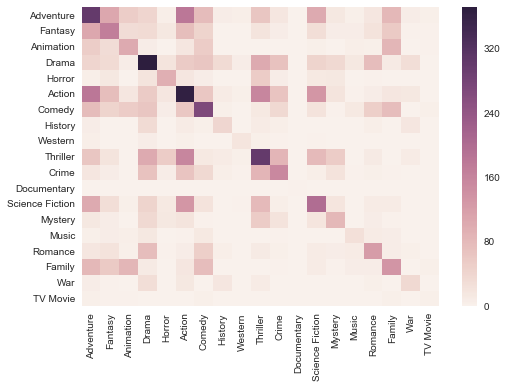

In [23]:
annot_lookup = []
for i in range(len(nr_ids)):
    annot_lookup.append(Genre_ID_to_name[nr_ids[i]])
sns.heatmap(visGrid,xticklabels=annot_lookup,yticklabels=annot_lookup)